### Summary figures

In [1]:
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"

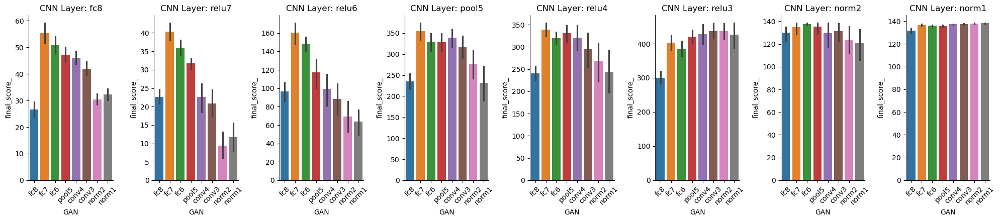

In [ ]:
# display `caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_barplot.png` 
from IPython.display import Image
Image(f"{evolsavedir}/caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_barplot.png")

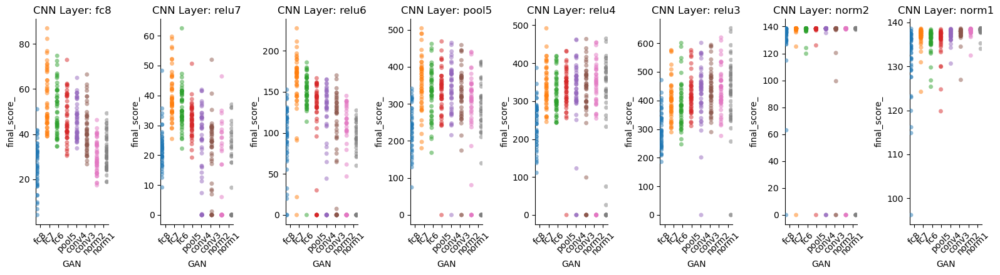

In [ ]:
# caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_stripplot.png
Image(f"{evolsavedir}/caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_stripplot.png")

In [5]:
!ls {evolsavedir}

^C


In [2]:
!ls {evolsavedir}

caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_barplot.pdf
caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_barplot.png
caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_stripplot.pdf
caffenet_invert_alignment_exp_pilot6_preproc_optimtuned_std1.0_alllayers_stripplot.png
results_collection_noCMA_pilot3.pkl
results_collection_noCMA_pilot4_preproc.pkl
results_collection_noCMA_pilot5_preproc_optimtuned.pkl
results_collection_noCMA_pilot6_preproc_optimtuned_std1.0.pkl
results_collection_noCMA.pkl
results_collection.pkl


In [11]:
from torchvision.utils import make_grid
from circuit_toolkit.plot_utils import to_imgrid, save_imgrid, saveallforms, show_imgrid

In [8]:
import pandas as pd
import pickle as pkl
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"

with open(f"{evolsavedir}/results_collection_noCMA_pilot6_preproc_optimtuned_std1.0.pkl", "rb") as f:
    results_collection = pkl.load(f)

# barplot_df = data_dict["barplot_df"]
# barplot_df.head()

In [9]:
print(len(results_collection))
print(list(results_collection[0].keys()))

3000
['CNN', 'GAN', 'unit_idx', 'final_score', 'final_best_img', 'scores', 'generations']


In [10]:
df = pd.DataFrame(results_collection)

### Visualizing optimal images for neurons / optimizers

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

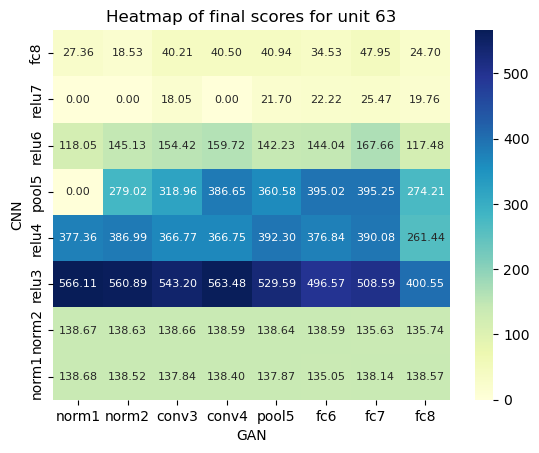

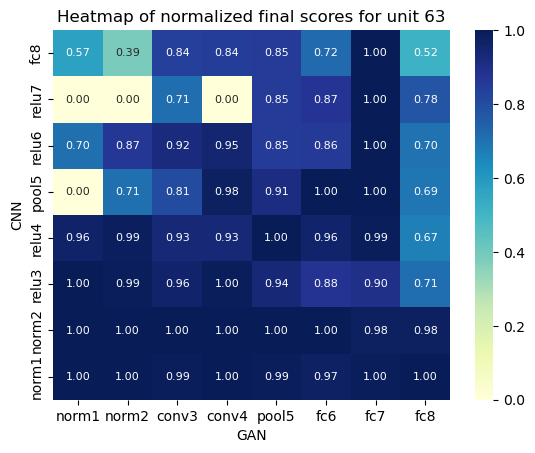

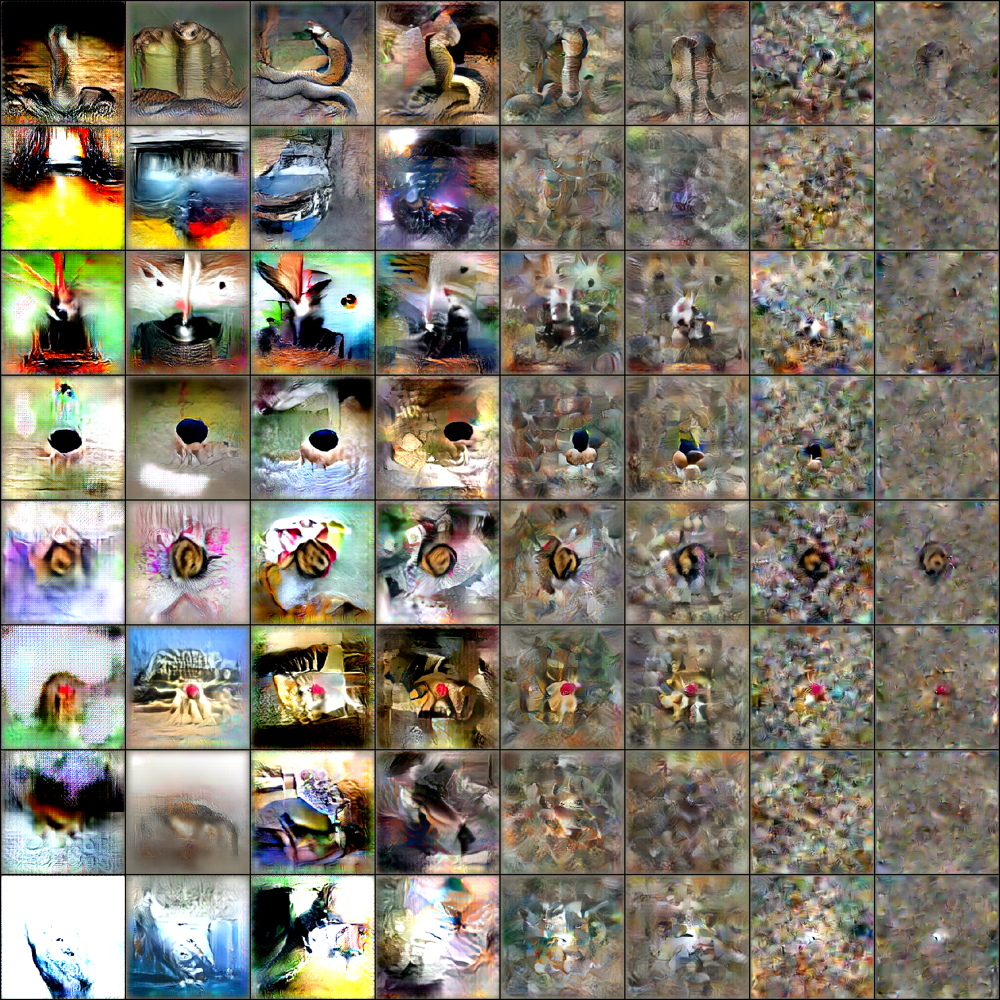

In [58]:
unit_idx = 63

df_part = df.query(f"unit_idx == {unit_idx}")[['CNN', 'GAN', 'final_score']]
# Get original orders from df_part
cnn_order = df_part['CNN'].unique()
gan_order = df_part['GAN'].unique()
# Create pivot table while preserving order
df_pivot = df_part.pivot(index='CNN', columns='GAN', values='final_score')
# Reorder rows and columns to match original
df_pivot = df_pivot.reindex(index=cnn_order, columns=reversed(gan_order))
sns.heatmap(df_pivot,
            annot=True, fmt='.2f', cmap='YlGnBu', annot_kws={"size": 8})
plt.title(f"Heatmap of final scores for unit {unit_idx}")
plt.show()
# plot another heatmap with normalized values across GANs
df_pivot_norm = df_pivot.div(df_pivot.max(axis=1), axis=0)
sns.heatmap(df_pivot_norm,
            annot=True, fmt='.2f', cmap='YlGnBu', annot_kws={"size": 8})
plt.title(f"Heatmap of normalized final scores for unit {unit_idx}")
plt.show()

df_part = df.query(f"unit_idx == {unit_idx}")
imgcol = []
for i in range(len(df_part)):
    imgcol.append(df_part.iloc[i].final_best_img)
display(to_imgrid(imgcol, nrow=8))


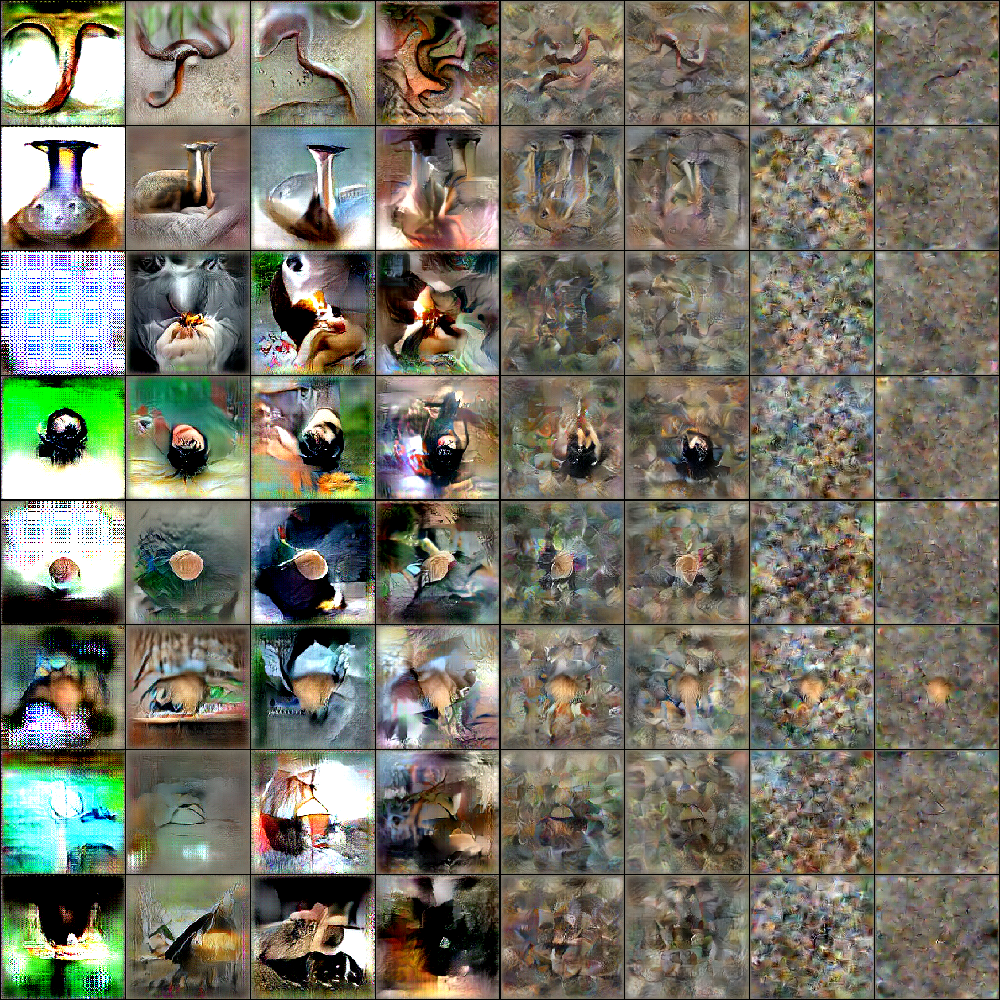

In [35]:
unit_idx = 52
df_part = df.query(f"unit_idx == {unit_idx}")
imgcol = []
for i in range(len(df_part)):
    imgcol.append(df_part.iloc[i].final_best_img)
display(to_imgrid(imgcol, nrow=8))

### Synopsis across units

In [59]:
gan_order

array(['fc8', 'fc7', 'fc6', 'pool5', 'conv4', 'conv3', 'norm2', 'norm1'],
      dtype=object)

In [56]:
df.drop(columns=['final_score_max'], inplace=True)
# compute the normalized final scores of each unit
df_max = df.groupby(['CNN', 'unit_idx']).agg({'final_score': 'max'})#.reset_index()
# merge df_max back to df
df = df.merge(df_max, on=['CNN', 'unit_idx'], suffixes=('', '_max'))
df["final_score_norm"] = df["final_score"] / df["final_score_max"]

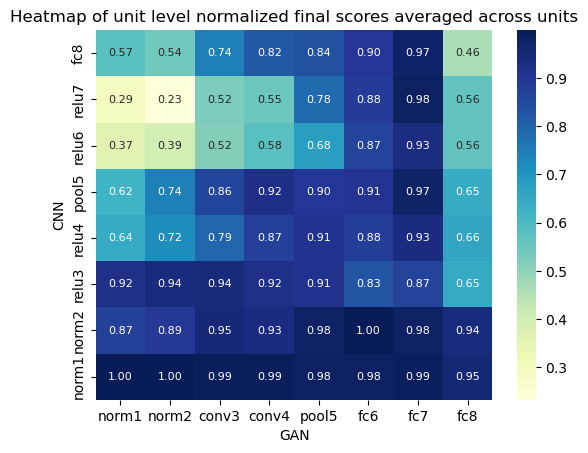

In [57]:
df_syn = df.groupby(['CNN', 'GAN']).agg({'final_score_norm': 'mean'}).reset_index()
df_part = df_syn
# Get original orders from df_part
cnn_order = ['norm1', 'norm2', 'relu3', 'relu4', 'pool5', 'relu6', 'relu7', 'fc8'] #df_part['CNN'].unique()
gan_order = ['norm1', 'norm2', 'conv3', 'conv4', 'pool5', 'fc6', 'fc7', 'fc8'] #df_part['GAN'].unique()
# Create pivot table while preserving order
df_pivot = df_part.pivot(index='CNN', columns='GAN', values='final_score_norm')
# Reorder rows and columns to match original
df_pivot = df_pivot.reindex(index=cnn_order, columns=(gan_order))
# do not reverse the y direction
sns.heatmap(df_pivot,
            annot=True, fmt='.2f', cmap='YlGnBu', annot_kws={"size": 8})
plt.gca().invert_yaxis()
plt.title(f"Heatmap of unit level normalized final scores averaged across units")
plt.show()


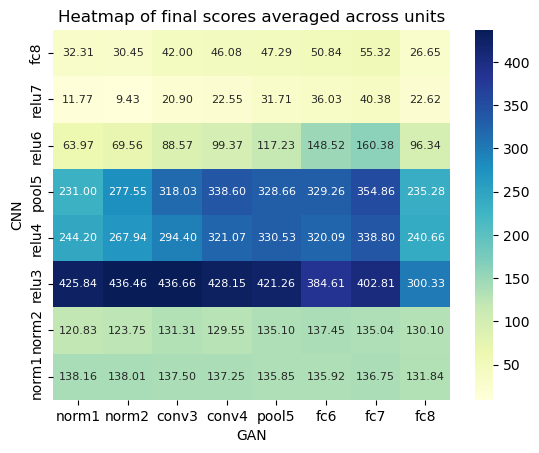

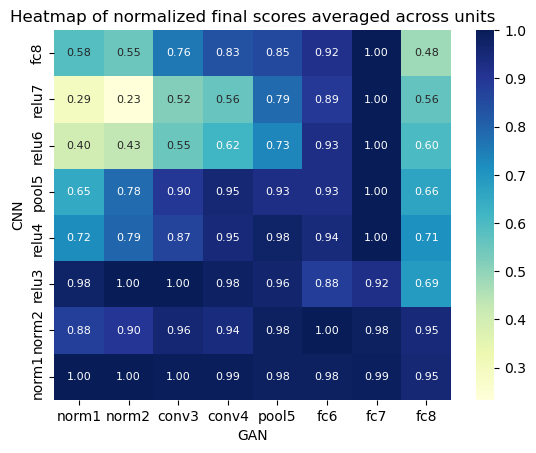

In [45]:
df_syn = df.groupby(['CNN', 'GAN']).agg({'final_score': 'mean'}).reset_index()
df_part = df_syn
# Get original orders from df_part
cnn_order = ['norm1', 'norm2', 'relu3', 'relu4', 'pool5', 'relu6', 'relu7', 'fc8'] #df_part['CNN'].unique()
gan_order = ['norm1', 'norm2', 'conv3', 'conv4', 'pool5', 'fc6', 'fc7', 'fc8'] #df_part['GAN'].unique()
# Create pivot table while preserving order
df_pivot = df_part.pivot(index='CNN', columns='GAN', values='final_score')
# Reorder rows and columns to match original
df_pivot = df_pivot.reindex(index=cnn_order, columns=(gan_order))
# do not reverse the y direction
sns.heatmap(df_pivot,
            annot=True, fmt='.2f', cmap='YlGnBu', annot_kws={"size": 8})
plt.gca().invert_yaxis()
plt.title(f"Heatmap of final scores averaged across units")
plt.show()
# plot another heatmap with normalized values across GANs
df_pivot_norm = df_pivot.div(df_pivot.max(axis=1), axis=0)
sns.heatmap(df_pivot_norm,
            annot=True, fmt='.2f', cmap='YlGnBu', annot_kws={"size": 8})
plt.gca().invert_yaxis()
plt.title(f"Heatmap of normalized final scores averaged across units")
plt.show()
